In [1]:
import re
import os 
import sys 

import numpy as np
import matplotlib.pyplot as plt
import skimage
from skimage import io

from pathlib import Path
from tqdm.notebook import trange, tqdm
from joblib import Parallel, delayed
from skimage import exposure
import h5py
import pandas as pd
import scanpy as sc
import squidpy as sq
sc.settings.verbosity = 3

from matplotlib.pyplot import rc_context
from sklearn.preprocessing import StandardScaler, MinMaxScaler

from functools import reduce
from matplotlib import cm, colors
import scanorama
import seaborn as sns 
import anndata as ad
from PIL import Image

import dask.dataframe as dd
import dask_ml.cluster 
import scipy
import umap

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
# Import path
module_path = str(Path.cwd().parents[0])
if module_path not in sys.path:
    sys.path.append(module_path)
    
module_path = str(Path.cwd().parents[0] / "src")
if module_path not in sys.path:
    sys.path.append(module_path)
    

In [4]:
from config import *
import my_io as io

In [5]:
data_ROI = data_dir / "ROI_new"

# Load data

In [6]:
from skimage.transform import rescale

def get_imgs(file_path, name):
    f = h5py.File(file_path, "r")
    imgs = f[name]
    labels = list(f[name].attrs["labels"])
    return imgs, labels

In [7]:
h5_data = data_ROI / f"TMA.hdf5"
df = pd.read_csv(data_ROI / f"info.csv")

ROIs = df.ROI.unique()
pixels_bright_list = []

for roi in tqdm(ROIs, total=len(ROIs)):
    imgs, markers = get_imgs(h5_data, str(roi))
    imgs = np.stack(imgs, axis=2)
    imgs = rescale(imgs, 0.5, preserve_range=True, multichannel=True)
    rows, cols = np.nonzero(np.any(imgs, axis=2))
    values = imgs[rows, cols,:]
    df_pixels = pd.DataFrame(values, columns=markers)
    df_pixels["X"] = rows
    df_pixels["Y"] = cols
    df_pixels['ROI'] = roi
    df_pixels = df_pixels.loc[~(df_pixels.iloc[:,:-3]<30).all(axis=1)]
    pixels_bright_list.append(df_pixels)

  0%|          | 0/12 [00:00<?, ?it/s]

# Pixels clustering

In [8]:
df_pixels = pd.concat(pixels_bright_list)

In [9]:
markers_subset = ['SMA', 'Vimentin', 'TCF1', 'CD163', 'Pankeratin', 'H3K9me3',
       'PDL1', 'CD103', 'CD206', 'CD11c', 'FoxP3', 'CD4', 'E-cadherin',
       'CD68', 'CD95', 'CD20', 'CD8', 'PD1', 'GranenzymeB', 'Ki67',
       'COL1', 'CD3', 'CD45Ro', 'HLADR', 'MHC-II', 'X', 'Y', 'ROI']

len(markers_subset)

28

In [10]:
df_pixels.reset_index(inplace=True, drop=True)
df_pixels = df_pixels.loc[:,markers_subset]

In [11]:
df_pixels

,SMA,Vimentin,TCF1,CD163,Pankeratin,H3K9me3,PDL1,CD103,CD206,CD11c,...,GranenzymeB,Ki67,COL1,CD3,CD45Ro,HLADR,MHC-II,X,Y,ROI
0,0.00,0.00,0.0,0.00,0.0,0.00,0.0,0.0,0.00,0.0,...,0.0,0.0,0.00,0.0,39.00,0.00,0.00,59,522,B7
1,0.00,0.00,0.0,0.00,0.0,0.00,0.0,0.0,0.00,0.0,...,0.0,0.0,0.00,0.0,33.50,0.00,0.00,59,523,B7
2,0.00,0.00,0.0,0.00,0.0,0.00,0.0,0.0,0.00,0.0,...,0.0,0.0,0.00,0.0,21.50,0.00,0.00,59,524,B7
3,0.00,0.00,0.0,0.00,49.0,0.00,0.0,0.0,0.00,0.0,...,0.0,0.0,0.00,0.0,0.00,0.00,0.00,60,300,B7
4,0.00,0.00,0.0,0.00,0.0,0.00,0.0,0.0,0.00,0.0,...,0.0,0.0,0.00,0.0,36.25,0.00,0.00,60,522,B7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5093779,10.00,15.50,0.0,3.50,0.0,5.50,0.0,0.0,3.50,0.0,...,0.0,0.0,72.25,0.0,46.50,58.75,6.25,749,745,H9
5093780,26.25,32.00,0.0,8.75,0.0,1.25,0.0,0.0,0.25,0.0,...,0.0,0.0,19.75,0.0,62.00,134.50,1.75,749,746,H9
5093781,25.25,39.75,0.0,0.50,0.0,0.00,0.0,0.0,0.00,0.0,...,0.0,0.0,48.50,0.0,91.50,142.75,19.25,749,747,H9
5093782,4.50,12.25,0.0,2.75,0.0,0.00,0.0,0.0,0.00,0.0,...,0.0,0.0,46.75,0.0,56.75,112.00,1.25,749,748,H9


In [12]:
# Scale data
scaler = MinMaxScaler()
x_scaled = scaler.fit_transform(df_pixels.iloc[:, :-3].values)
pixels_scaled = pd.DataFrame(x_scaled, columns=df_pixels.columns[:-3], index=df_pixels.index)

In [13]:
X = dd.from_pandas(pixels_scaled, chunksize=100000)

In [14]:
X = X.persist()
X

,SMA,Vimentin,TCF1,CD163,Pankeratin,H3K9me3,PDL1,CD103,CD206,CD11c,FoxP3,CD4,E-cadherin,CD68,CD95,CD20,CD8,PD1,GranenzymeB,Ki67,COL1,CD3,CD45Ro,HLADR,MHC-II
npartitions=51,,,,,,,,,,,,,,,,,,,,,,,,,
0,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
100000,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5000000,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5093783,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...


In [15]:
km = dask_ml.cluster.KMeans(n_clusters=20, oversampling_factor=10, random_state=0)
km.fit(X)

KMeans(n_clusters=20, oversampling_factor=10, random_state=0)

In [16]:
labels = km.labels_
labels = labels.compute()

# Viz

In [17]:
scaler = StandardScaler()
x_scaled = scaler.fit_transform(pixels_scaled)
pixels_bright_position = pd.DataFrame(x_scaled, columns=pixels_scaled.columns, index=pixels_scaled.index)

In [18]:
pixels_bright_position["label"] = labels

# Get dataframe per cluster
df_per_label = pixels_bright_position.groupby("label").mean()
df_per_label.head()

,SMA,Vimentin,TCF1,CD163,Pankeratin,H3K9me3,PDL1,CD103,CD206,CD11c,...,CD20,CD8,PD1,GranenzymeB,Ki67,COL1,CD3,CD45Ro,HLADR,MHC-II
label,,,,,,,,,,,,,,,,,,,,,
0,-0.049516,0.333460,0.206647,3.514027,-0.253238,-0.454581,0.179964,-0.000772,3.330565,0.259944,...,-0.074325,-0.055148,-0.056986,-0.104270,-0.208488,0.052615,-0.083080,0.312156,0.596422,0.323051
1,-0.270625,-0.307065,0.327030,-0.246045,0.224653,1.238326,0.740054,-0.088293,-0.195539,0.031699,...,-0.138034,-0.221615,-0.030571,-0.174998,0.020880,-0.484795,0.265070,0.273553,-0.206776,-0.265909
2,0.118545,-0.124064,1.215342,0.148596,1.348799,2.512448,1.936187,-0.048302,-0.026868,0.838636,...,-0.135952,0.355264,0.471524,-0.018785,0.625307,-0.310478,1.446608,1.362410,0.498318,0.220536
3,-0.401470,-0.366000,-0.431329,-0.276408,-0.383414,-0.402492,-0.597752,-0.132063,-0.193667,-0.616511,...,-0.127151,-0.440507,-0.073255,-0.211925,-0.221409,-0.462175,-0.476629,-0.504474,-0.457245,-0.582181
4,-0.196174,0.062496,0.085988,-0.109241,1.154122,-0.050338,0.340186,-0.008572,-0.088060,0.675752,...,-0.122172,0.684241,-0.043097,-0.024714,-0.093447,-0.330321,-0.122244,-0.146204,2.129148,2.017825


In [19]:
my_cmap = "bwr"
scale_name = "Z-score"

In [20]:
import scipy.cluster.hierarchy as sch
import matplotlib 
from collections import defaultdict

def create_HM(
    df_per_label, my_cmap, row_colors, scale_name, cellSizePixels=30, **kwargs
):
    # Calulate the figure size, this gets us close, but not quite to the right place
    dpi = matplotlib.rcParams["figure.dpi"]
    marginWidth = (
        matplotlib.rcParams["figure.subplot.right"]
        - matplotlib.rcParams["figure.subplot.left"]
    )
    marginHeight = (
        matplotlib.rcParams["figure.subplot.top"]
        - matplotlib.rcParams["figure.subplot.bottom"]
    )
    Ny, Nx = df_per_label.shape
    figWidth = (Nx * cellSizePixels / dpi) / marginWidth
    figHeigh = (Ny * cellSizePixels / dpi) / marginHeight

    ax = sns.clustermap(
        df_per_label,
        cbar_kws={"fraction": 0.01},
        cmap=my_cmap,
        linewidth=0.1,
        col_cluster=False,
        row_colors=[row_colors],
        dendrogram_ratio=(0.1, 0.0),
        figsize=(figWidth, figHeigh),
        **kwargs,
    )
    ax.ax_heatmap.set_yticklabels(ax.ax_heatmap.get_yticklabels(), rotation=0)
    ax.ax_heatmap.set_xticklabels(
        ax.ax_heatmap.get_xticklabels(), rotation=45, horizontalalignment="right"
    )
    ax.ax_heatmap.set_xlabel("Marker")
    ax.ax_heatmap.set_ylabel("Cluster")

    # calculate the size of the heatmap axes
    axWidth = (Nx * cellSizePixels) / (figWidth * dpi)
    axHeight = (Ny * cellSizePixels) / (figHeigh * dpi)

    # resize heatmap
    ax_heatmap_orig_pos = ax.ax_heatmap.get_position()
    ax.ax_heatmap.set_position(
        [ax_heatmap_orig_pos.x0, ax_heatmap_orig_pos.y0, axWidth, axHeight]
    )

    # resize dendrograms to match
    ax_row_orig_pos = ax.ax_row_dendrogram.get_position()
    ax.ax_row_dendrogram.set_position(
        [ax_row_orig_pos.x0, ax_row_orig_pos.y0, ax_row_orig_pos.width, axHeight]
    )
    ax_row_orig_pos = ax.ax_row_colors.get_position()
    ax.ax_row_colors.set_position(
        [ax_row_orig_pos.x0, ax_row_orig_pos.y0, ax_row_orig_pos.width, axHeight]
    )
    
    pos = ax.ax_heatmap.get_position()
    cbar_size=0.2
    ax.ax_cbar.set_position((1.05, pos.y0, .03, cbar_size))

    # Change colorbar label position
    cbar = ax.ax_heatmap.collections[0].colorbar
    cbar.set_label(scale_name, fontsize=12)

    for _, spine in ax.ax_heatmap.spines.items():
        spine.set_visible(True)
        spine.set_linewidth(3)


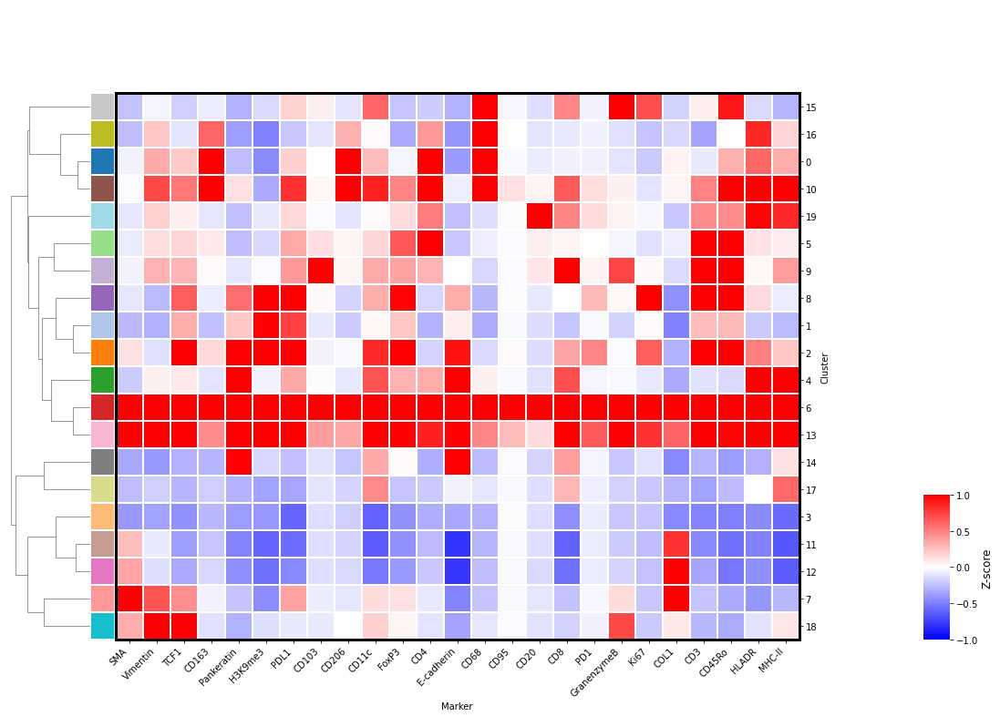

In [21]:
# Get linkage
d = sch.distance.pdist(df_per_label, metric='cosine')
L = sch.linkage(d, method="average")

# Get colormap
vals = np.linspace(0, 1, len(df_per_label))
my_cmap_row = plt.cm.tab20(vals)

# Clustermap and umap
labels = df_per_label.index.to_list()
my_cmap_dict = dict(zip(labels, my_cmap_row))
row_colors = pd.DataFrame(labels)[0].map(my_cmap_dict)
create_HM(df_per_label, my_cmap, row_colors, scale_name, row_linkage=L, vmin=-1, vmax=1)
plt.show()

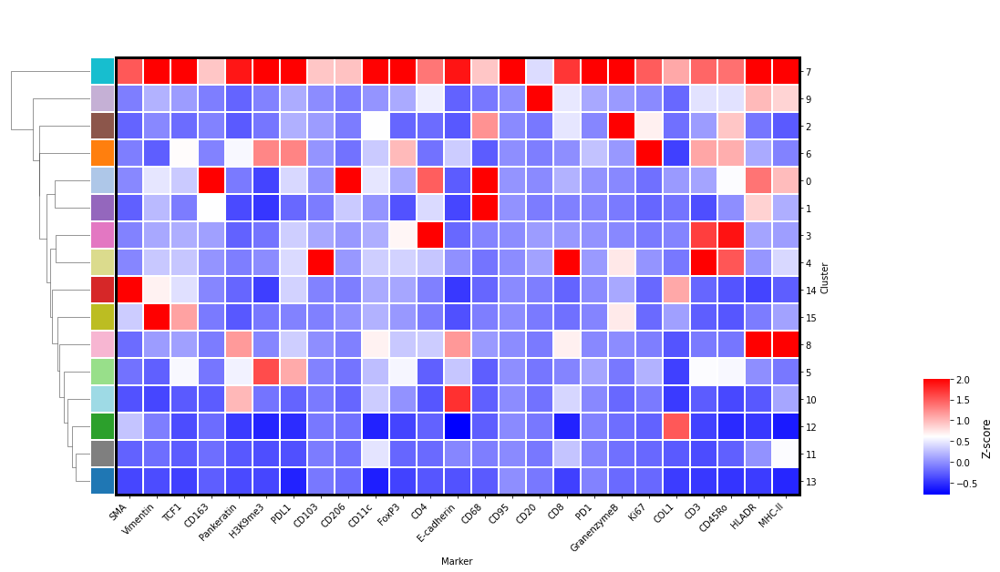

In [22]:
tol = 0.23

# Merge similar cluster
clusters = sch.fcluster(L, tol * d.max(), "distance") - 1
clusters_unique = np.unique(clusters)
n_clusters = len(np.unique(clusters))

# Clustermap and umap
label2cluster = dict(zip(labels, clusters))
result = defaultdict(int)
for k, v in zip(clusters, labels):
    result[k] = max(result[k], v)
row_colors = pd.DataFrame(labels)[0].map(label2cluster).map(result).map(my_cmap_dict)
clusters = np.array(list(map(label2cluster.get, labels)))
new_parc_labels = np.array(list(map(result.get, clusters)))
# create_HM(df_per_label, my_cmap, row_colors, scale_name, row_linkage=L)

# Clustermap and umap with new colormap
vals = np.linspace(0, 1, n_clusters)
np.random.seed(0)
np.random.shuffle(vals)
my_cmap_row = plt.cm.tab20(vals)
my_cmap_dict = dict(zip(clusters_unique, my_cmap_row))
row_colors = pd.DataFrame(labels)[0].map(label2cluster).map(my_cmap_dict)
new_parc_labels = np.array(list(map(label2cluster.get, labels)))
# create_HM(df_per_label, my_cmap, row_colors, scale_name, row_linkage=L)

# Combined 
df_combined = pixels_bright_position.copy()
df_combined.label = df_combined.label.map(label2cluster.get)
df_combined = df_combined.groupby("label").mean()
labels = df_combined.index.to_list()

row_colors = pd.DataFrame(labels)[0].map(my_cmap_dict)

create_HM(df_combined, my_cmap, row_colors, scale_name, vmax=2)
plt.show()

# Pixel location visualization

First we add back the location and condition information in the pixel_bright dataframe

In [23]:
def create_image_cluster(df, mask, label2cluster=None):
    # Create image from pixel location
    x_max, y_max = mask.shape

    x = df.X.tolist()
    y = df.Y.tolist()
    if label2cluster:
        values = df.label.map(label2cluster).tolist()
    else:
        values = np.array(df.label.tolist())
        
    img = np.zeros((x_max, y_max)) * np.nan
    img[x, y] = values
    return img, x, y, values

def fov_cluster(img, my_cmap, savepath=None):
    # Get random colormap
    my_cmap_pixel = plt.cm.colors.ListedColormap(my_cmap)

    # Show contour
    fig, ax = plt.subplots(figsize=(20, 20))
    ax.imshow(img, cmap=my_cmap_pixel, interpolation="none", vmin=0, vmax=len(my_cmap)-1)
    for spine in ax.spines.values():
        spine.set_visible(False)
    ax.tick_params(bottom=False, labelbottom=False,
                   left=False, labelleft=False)
    ax.patch.set_facecolor("k")
    if savepath:
        fig.savefig(savepath, bbox_inches="tight")


  0%|          | 0/12 [00:00<?, ?it/s]

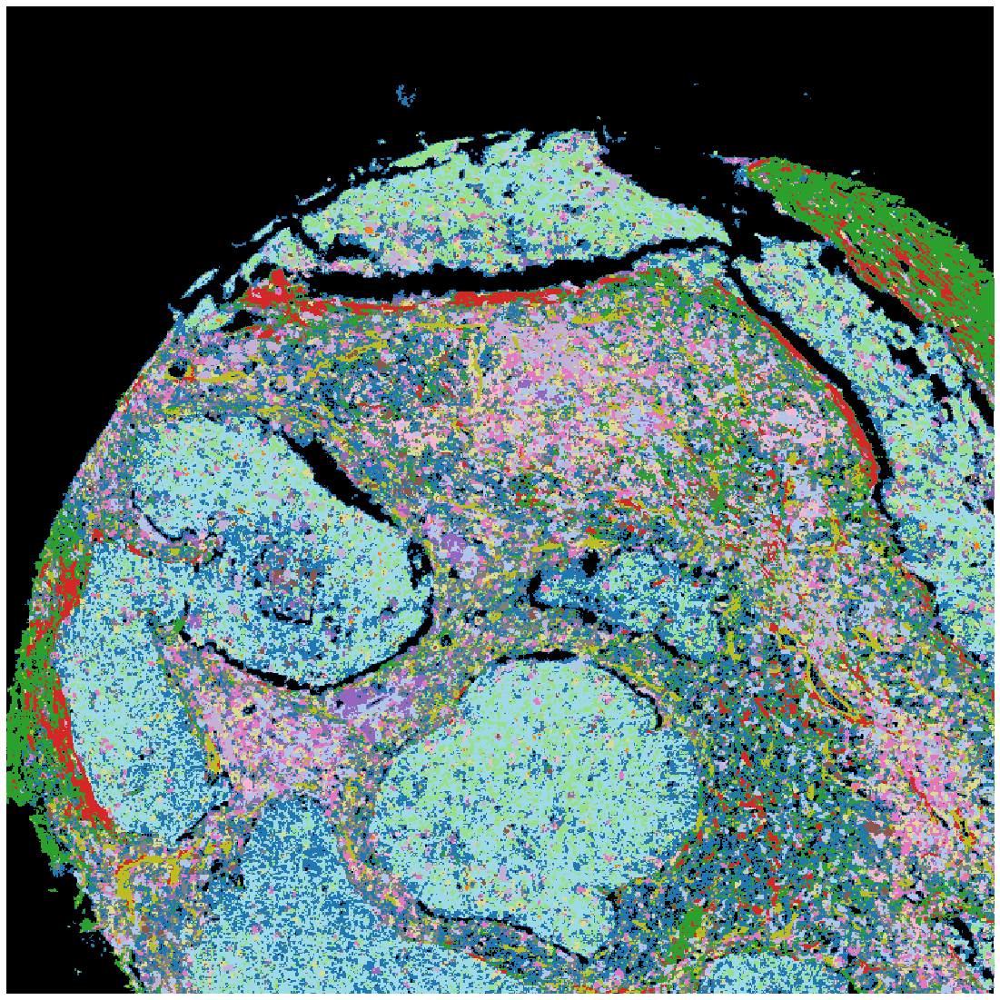

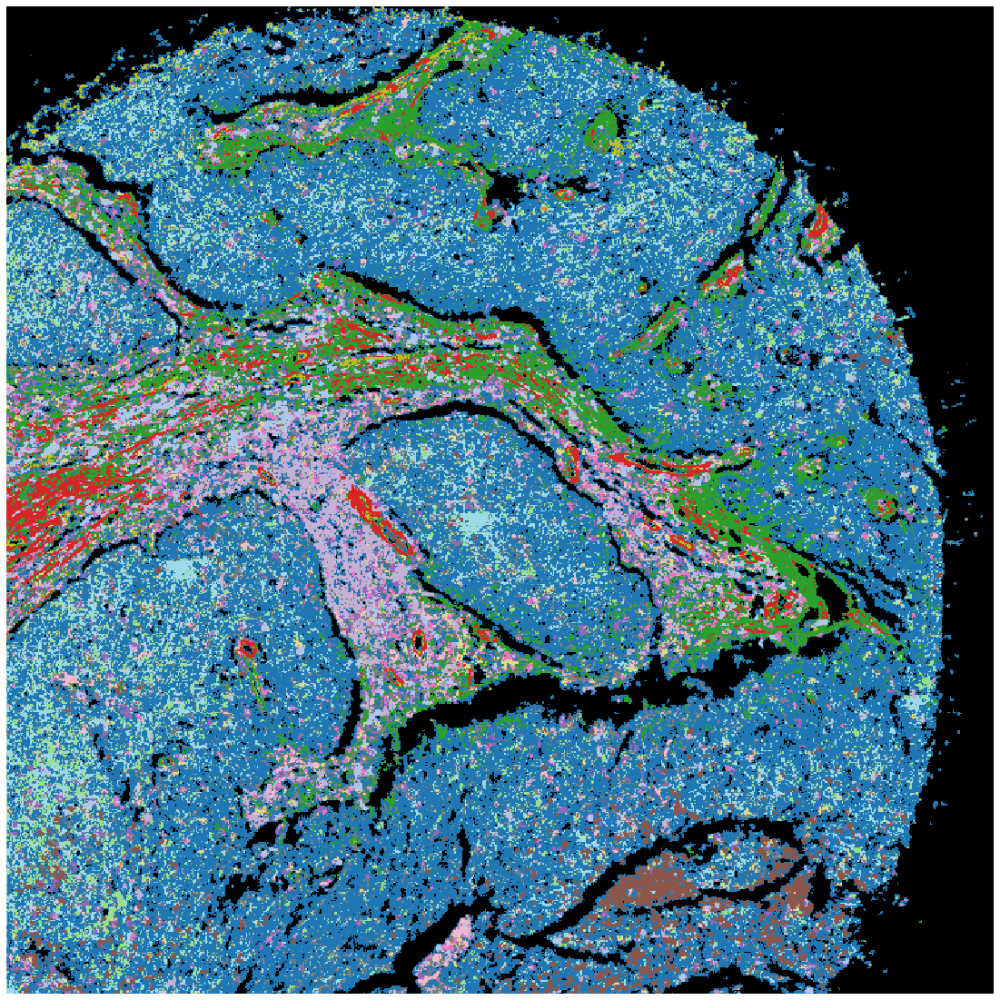

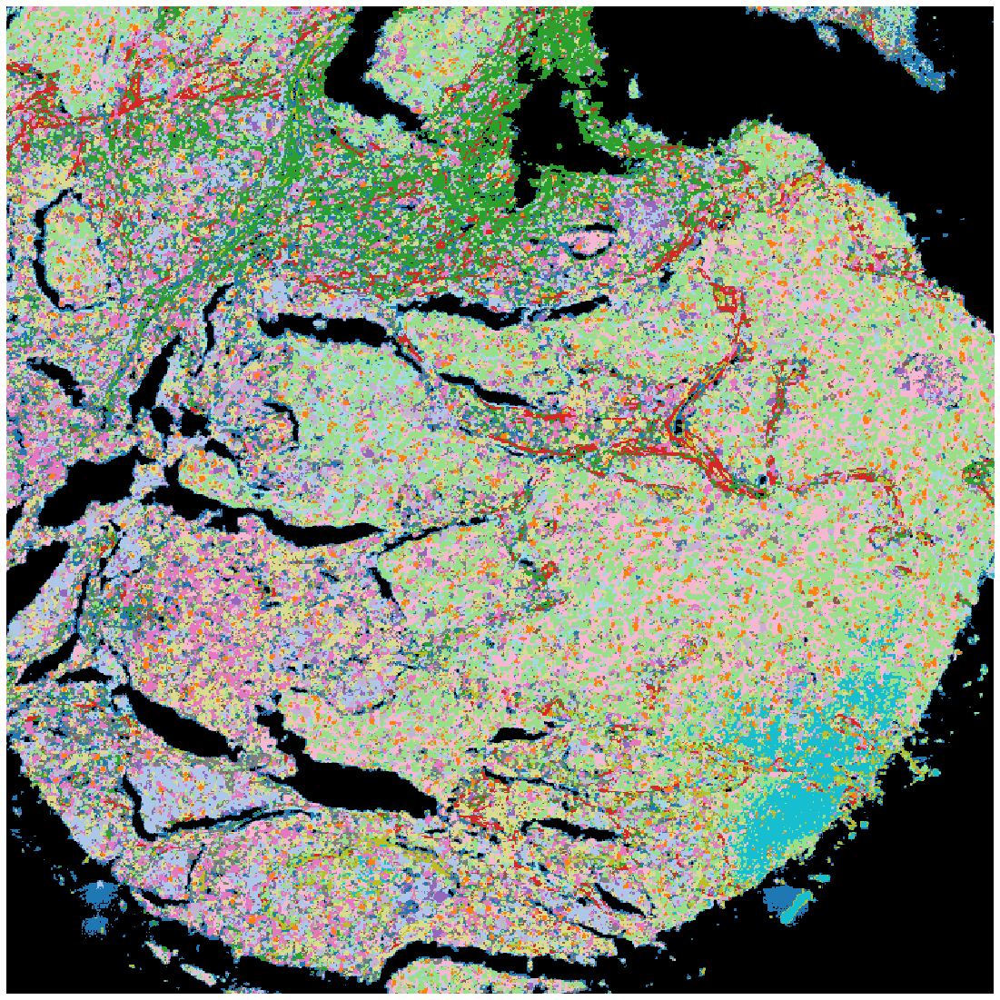

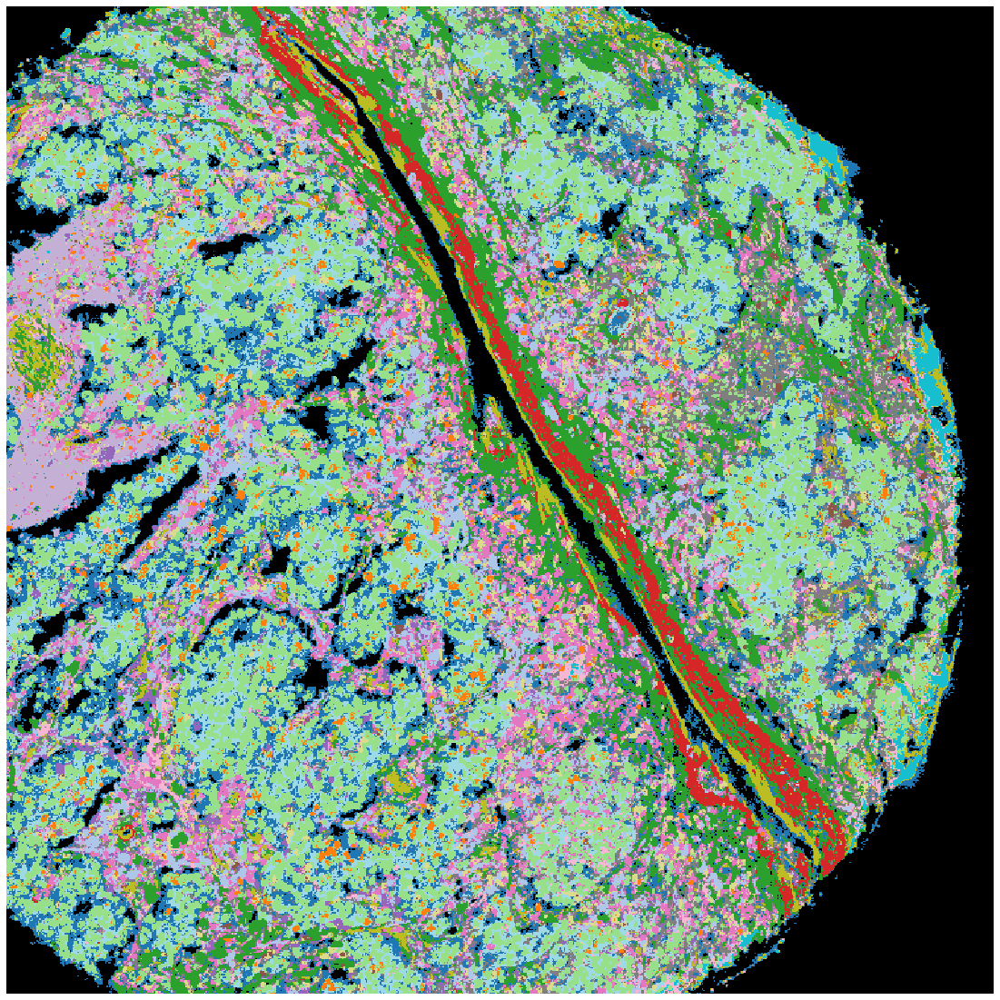

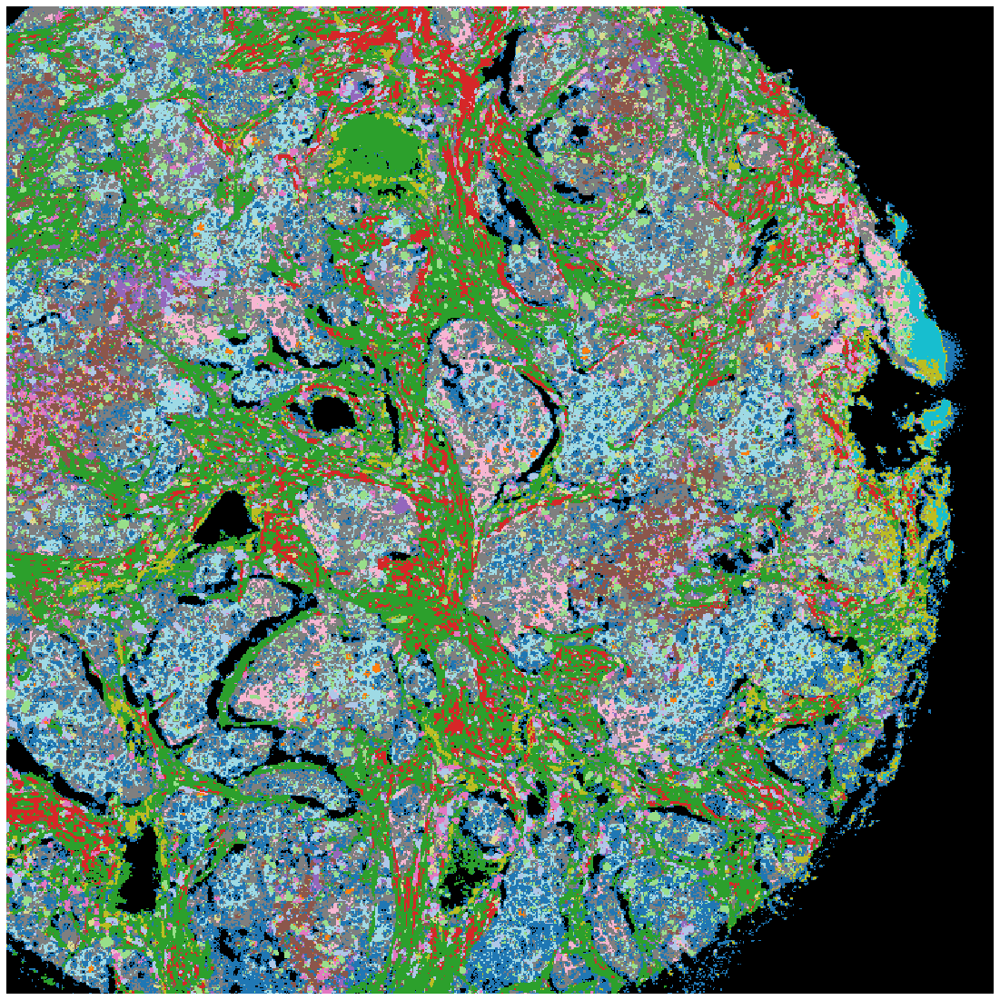

...

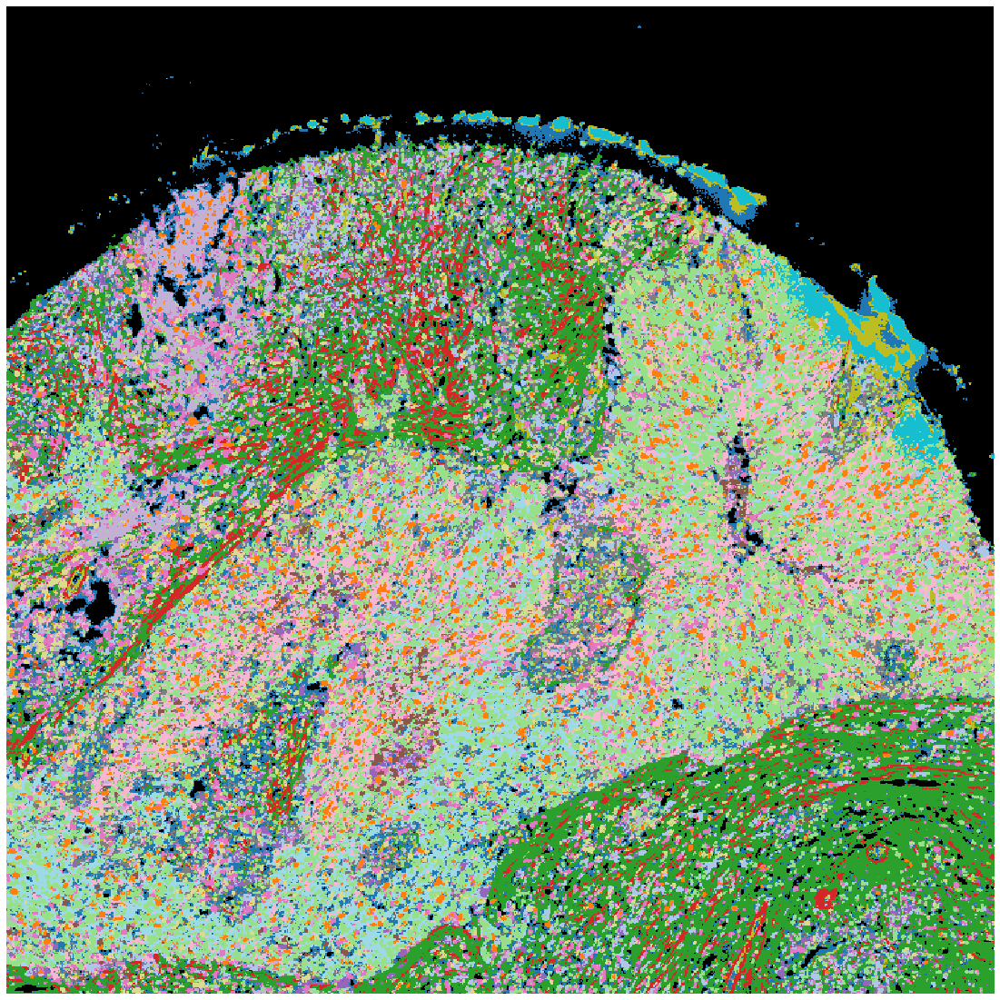

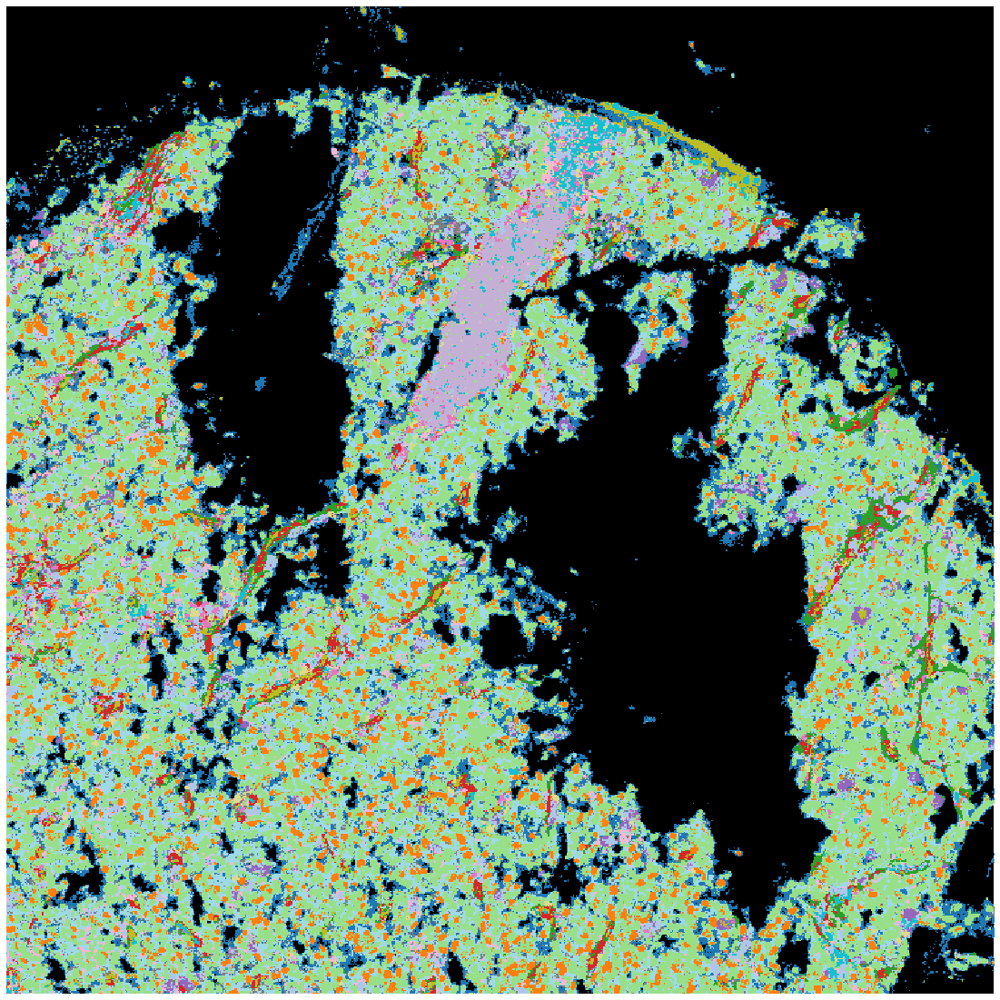

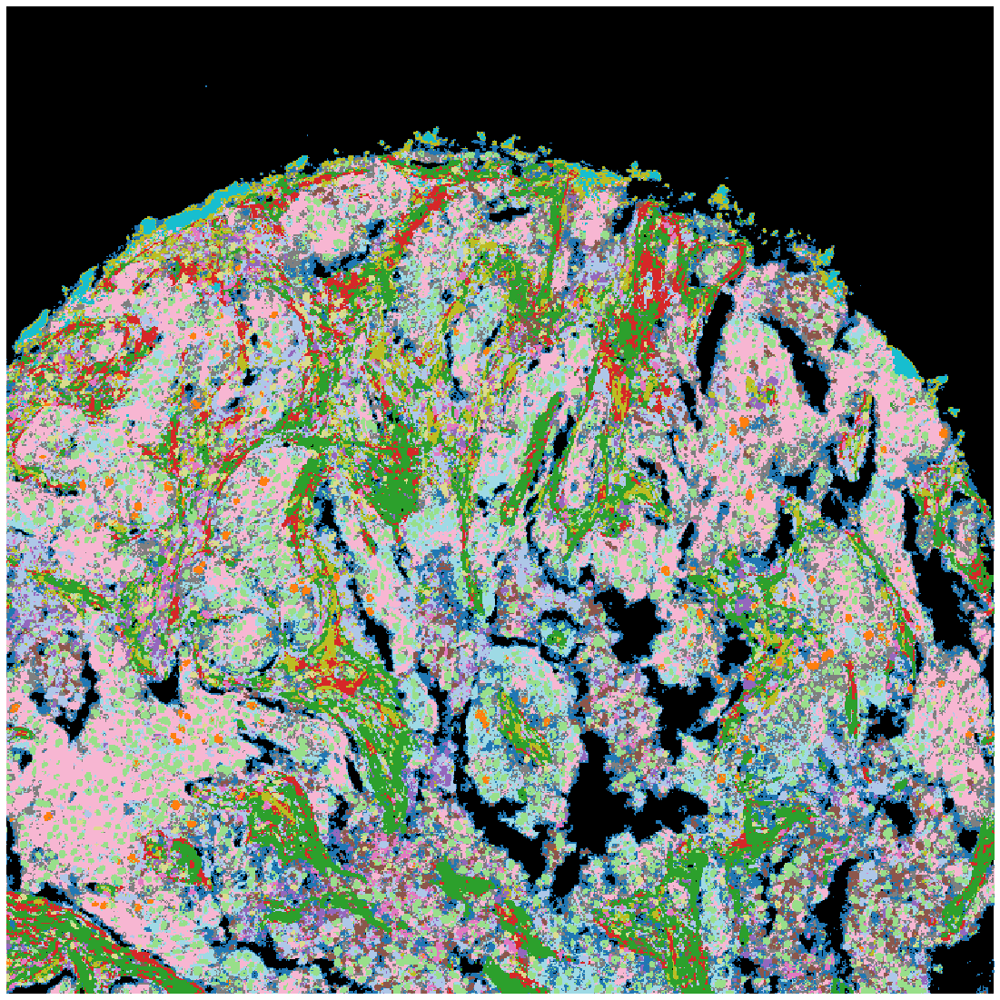

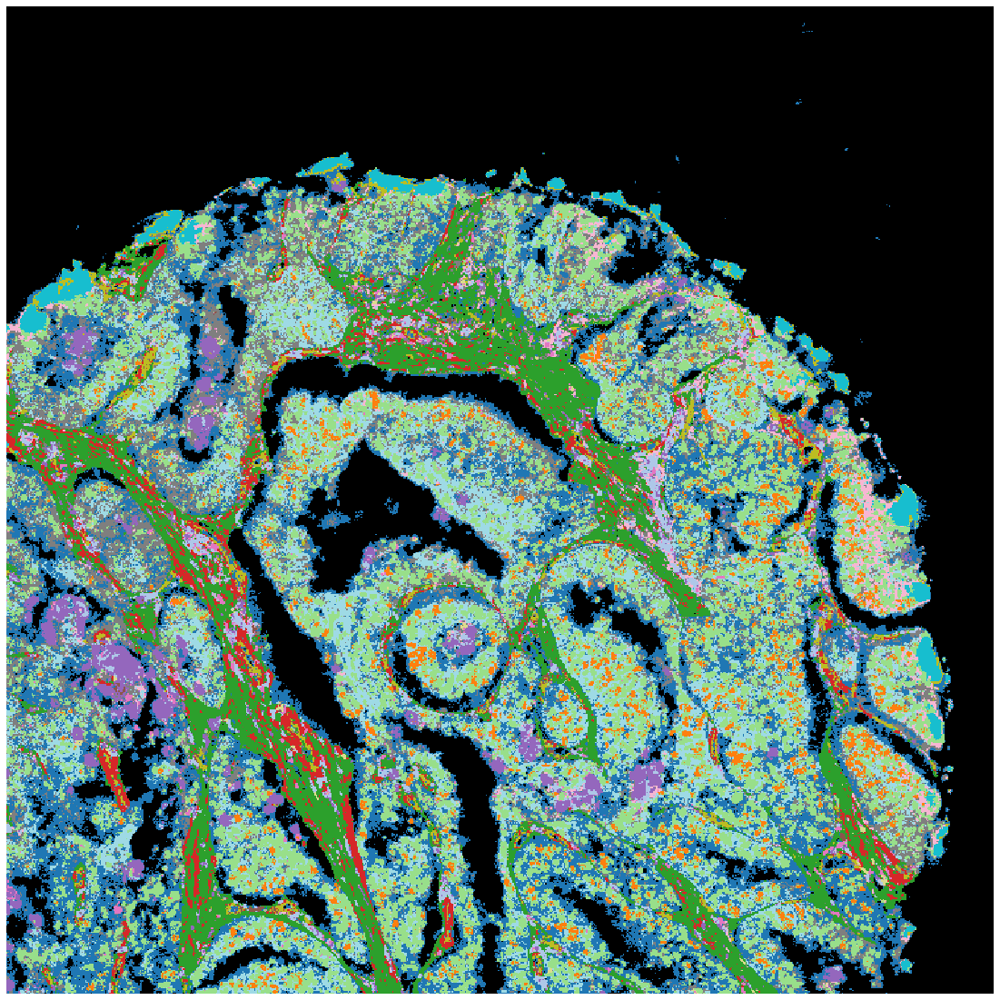

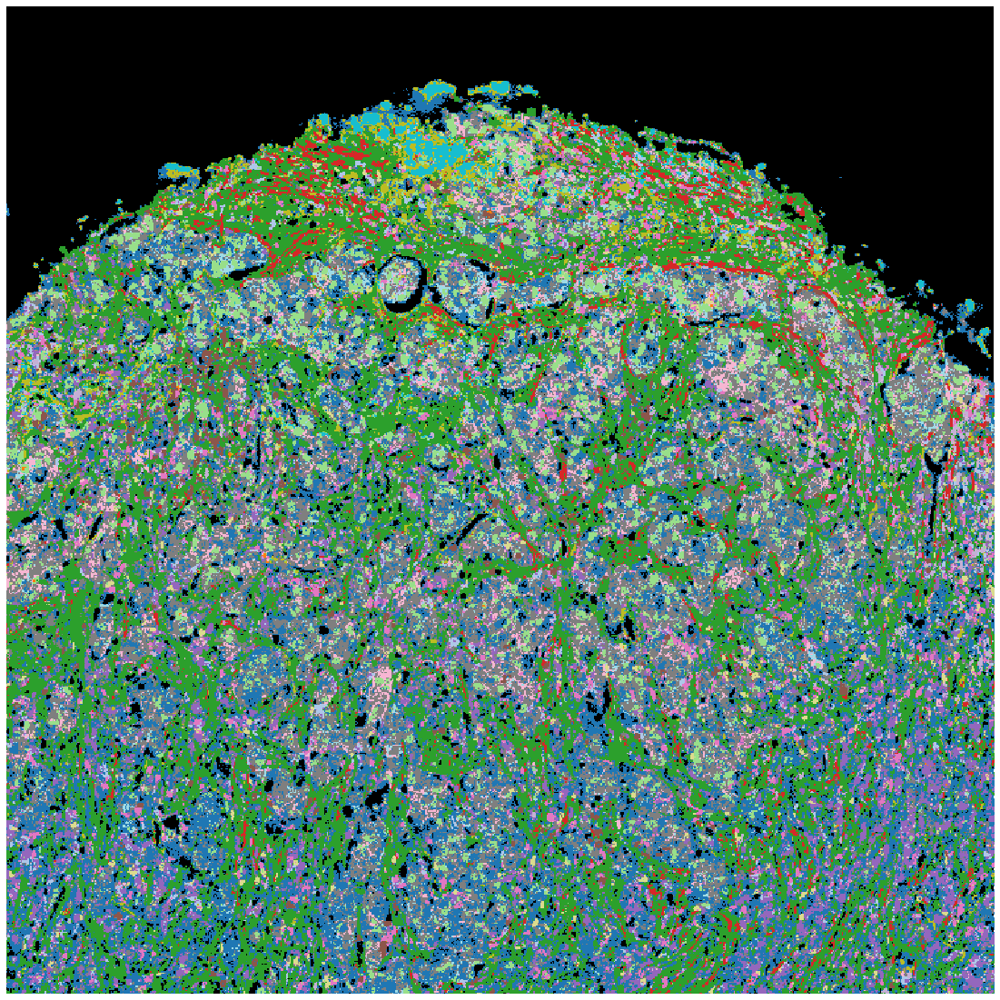

In [24]:
df = pixels_bright_position.join(df_pixels[['X','Y', 'ROI']])

for roi in tqdm(ROIs, total=len(ROIs)):
    df_subset = df[df.ROI == roi]
    img, _,_,_ = create_image_cluster(df_subset, imgs[:,:,0], label2cluster)
    fov_cluster(img, my_cmap_row)

In [25]:
def create_HM_count(
    df_per_label, my_cmap, row_colors, scale_name, cellSizePixels=40, **kwargs
):
    # Calulate the figure size, this gets us close, but not quite to the right place
    dpi = matplotlib.rcParams["figure.dpi"]
    marginWidth = (
        matplotlib.rcParams["figure.subplot.right"]
        - matplotlib.rcParams["figure.subplot.left"]
    )
    marginHeight = (
        matplotlib.rcParams["figure.subplot.top"]
        - matplotlib.rcParams["figure.subplot.bottom"]
    )
    Ny, Nx = df_per_label.shape
    figWidth = (Nx * cellSizePixels / dpi) / marginWidth
    figHeigh = (Ny * cellSizePixels / dpi) / marginHeight

    ax = sns.clustermap(
        df_per_label,
        cbar_kws={"fraction": 0.01},
        cmap=my_cmap,
        linewidth=0.1,
        row_cluster=False,
        row_colors=[row_colors],
         dendrogram_ratio=(0.0, 0.1),
        figsize=(figWidth, figHeigh),
        **kwargs,
    )
    ax.ax_heatmap.set_yticklabels(ax.ax_heatmap.get_yticklabels(), rotation=0)
    ax.ax_heatmap.set_xlabel("Marker")
    ax.ax_heatmap.set_ylabel("Cluster")

    # calculate the size of the heatmap axes
    axWidth = (Nx * cellSizePixels) / (figWidth * dpi)
    axHeight = (Ny * cellSizePixels) / (figHeigh * dpi)

    # resize heatmap
    ax_heatmap_orig_pos = ax.ax_heatmap.get_position()
    ax.ax_heatmap.set_position(
        [ax_heatmap_orig_pos.x0, ax_heatmap_orig_pos.y0, axWidth, axHeight]
    )

    ax_row_orig_pos = ax.ax_row_colors.get_position()
    ax.ax_row_colors.set_position(
        [ax_row_orig_pos.x0, ax_row_orig_pos.y0, ax_row_orig_pos.width, axHeight]
    )
    
    ax_col_orig_pos = ax.ax_col_dendrogram.get_position()
    ax.ax_col_dendrogram.set_position([ax_col_orig_pos.x0, ax_heatmap_orig_pos.y0+axHeight,
                                         axWidth, ax_col_orig_pos.height])
    
    pos = ax.ax_heatmap.get_position()
    cbar_size=0.2
    ax.ax_cbar.set_position((1.1, pos.y0, .03, cbar_size))

    # Change colorbar label position
    cbar = ax.ax_heatmap.collections[0].colorbar
    cbar.set_label(scale_name, fontsize=12)

    for _, spine in ax.ax_heatmap.spines.items():
        spine.set_visible(True)
        spine.set_linewidth(3)


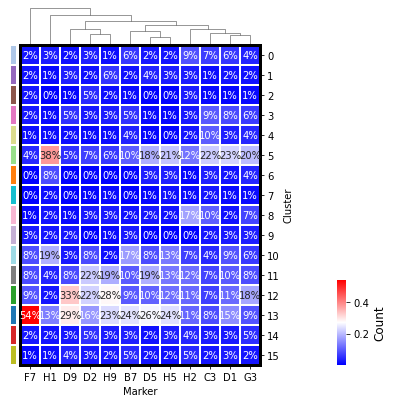

In [26]:
from matplotlib.colors import LogNorm

df_count = df.copy()
df_count.label = df_count.label.map(label2cluster.get)
df_count = df_count.groupby(['ROI', 'label']).size().reset_index(name='counts')
df_count = df_count.pivot(index='ROI', columns='label', values='counts')
df_count.fillna(0, inplace=True)

df_count = df_count.div(df_count.sum(axis=1), axis=0)
df_count.index = [index[-2:] for index in df_count.index]

create_HM_count(df_count.T, "bwr", row_colors, 'Count', cellSizePixels=20, annot=True, fmt=".0%")

In [27]:
pixels_bright_position

,SMA,Vimentin,TCF1,CD163,Pankeratin,H3K9me3,PDL1,CD103,CD206,CD11c,...,CD8,PD1,GranenzymeB,Ki67,COL1,CD3,CD45Ro,HLADR,MHC-II,label
0,-0.561988,-0.641310,-0.52113,-0.338436,-0.502554,-0.748758,-0.759786,-0.147701,-0.243595,-1.036682,...,-1.109904,-0.075014,-0.264324,-0.257071,-0.664370,-0.572127,-0.094754,-0.915737,-1.266331,3
1,-0.561988,-0.641310,-0.52113,-0.338436,-0.502554,-0.748758,-0.759786,-0.147701,-0.243595,-1.036682,...,-1.109904,-0.075014,-0.264324,-0.257071,-0.664370,-0.572127,-0.231428,-0.915737,-1.266331,3
2,-0.561988,-0.641310,-0.52113,-0.338436,-0.502554,-0.748758,-0.759786,-0.147701,-0.243595,-1.036682,...,-1.109904,-0.075014,-0.264324,-0.257071,-0.664370,-0.572127,-0.529625,-0.915737,-1.266331,3
3,-0.561988,-0.641310,-0.52113,-0.338436,1.012127,-0.748758,-0.759786,-0.147701,-0.243595,-1.036682,...,-1.109904,-0.075014,-0.264324,-0.257071,-0.664370,-0.572127,-1.063895,-0.915737,-1.266331,3
4,-0.561988,-0.641310,-0.52113,-0.338436,-0.502554,-0.748758,-0.759786,-0.147701,-0.243595,-1.036682,...,-1.109904,-0.075014,-0.264324,-0.257071,-0.664370,-0.572127,-0.163091,-0.915737,-1.266331,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5093779,-0.285022,-0.211403,-0.52113,-0.220574,-0.502554,-0.621839,-0.759786,-0.147701,-0.091849,-1.036682,...,-0.447799,-0.075014,-0.264324,-0.257071,1.060285,-0.572127,0.091620,0.538462,-1.108107,11
5093780,0.165047,0.246241,-0.52113,-0.043782,-0.502554,-0.719913,-0.759786,-0.147701,-0.232756,-1.036682,...,0.090615,-0.075014,-0.264324,-0.257071,-0.192924,-0.572127,0.476791,2.413449,-1.222029,16
5093781,0.137351,0.461194,-0.52113,-0.321599,-0.502554,-0.748758,-0.759786,-0.147701,-0.243595,-1.036682,...,-0.287730,-0.075014,-0.264324,-0.257071,0.493357,-0.572127,1.209859,2.617656,-0.779001,16
5093782,-0.437353,-0.301545,-0.52113,-0.245830,-0.502554,-0.748758,-0.759786,-0.147701,-0.243595,-1.036682,...,-1.029869,-0.075014,-0.264324,-0.257071,0.451583,-0.572127,0.346330,1.856522,-1.234687,11


In [28]:
n = 100
df_subset = pixels_bright_position.iloc[::n, :-1]
labels_subset = pixels_bright_position.iloc[::n, -1]

Umap embedding


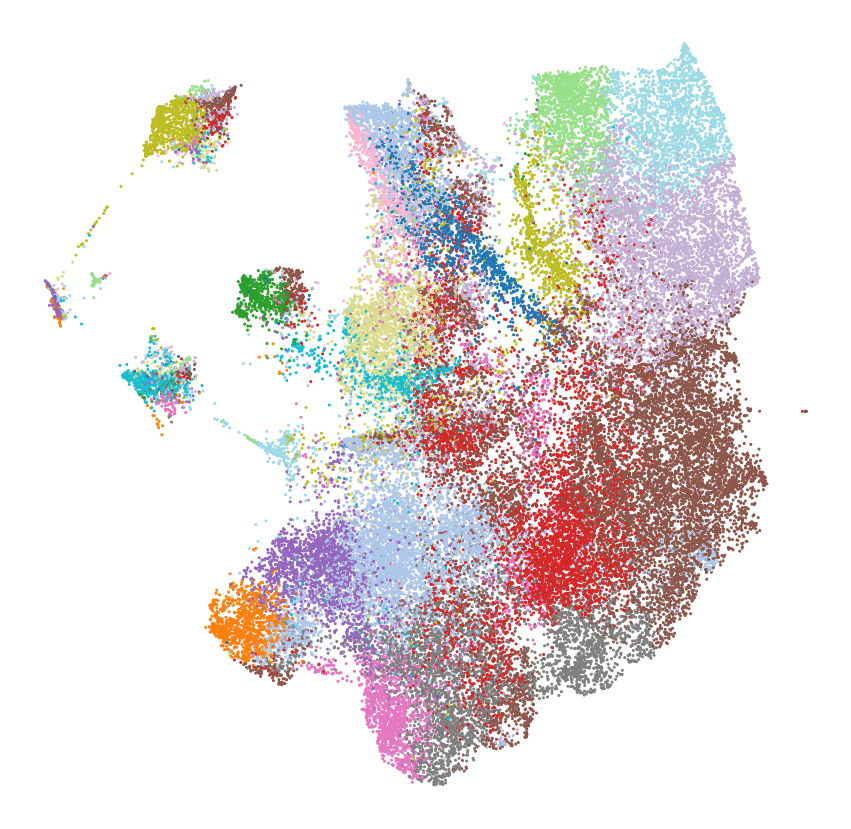

In [29]:
import scipy
import umap
sparse_mat = scipy.sparse.csr_matrix(df_subset.values)

print('Umap embedding')
# embeddings = umap.UMAP(n_neighbors=10, min_dist=0).fit_transform(sparse_mat)
embeddings = umap.UMAP().fit_transform(sparse_mat)


fig, ax = plt.subplots(figsize=(15, 15))
X, Y = embeddings[:, 0], embeddings[:, 1]
ax.scatter(X, Y, c=labels_subset, s=4, cmap=matplotlib.colors.ListedColormap(my_cmap_row))
ax.axis("off")
plt.show()
    


In [30]:
import scanpy as sc
import anndata as ad

adata = ad.AnnData(df_subset.reset_index(drop=True))
adata.var_names = df_subset.columns.tolist()
adata.obsm['X_umap'] = embeddings

C:\Users\thu71\Anaconda3\envs\new_codex\lib\site-packages\anndata\_core\anndata.py:120: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


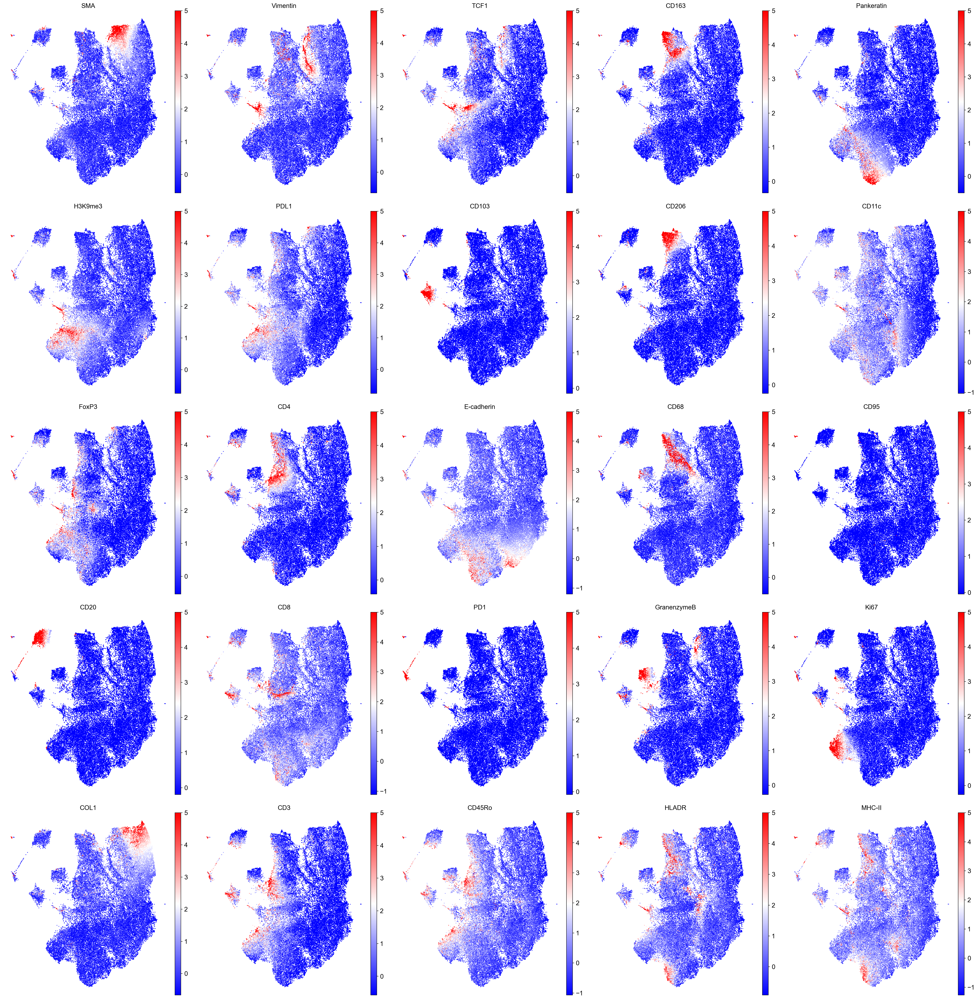

In [31]:
sc.set_figure_params(format='png')

with rc_context({'figure.figsize': (7, 7), 'figure.dpi': 100}):
    fig = sc.pl.umap(adata, color=adata.var_names, size=10,
                    frameon=False, ncols=5, cmap='bwr', hspace=0.1, wspace=0.05, vmax=5)

# Neighborhood analysis

In [ ]:
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import MiniBatchKMeans
from kneed import KneeLocator
from matplotlib.ticker import MaxNLocator
from matplotlib.pyplot import rc_context

def get_NN(adata, n):
    data = adata.obsm['spatial']
    fit = NearestNeighbors(n_neighbors=n+1).fit(data)
    # fit = NearestNeighbors(n_neighbors=n).fit(data)
    m = fit.kneighbors(data)
    m = m[0][:,1:], m[1][:,1:]
    # m = m[0], m[1] # Distances, Indices

    #sort_neighbors
    args = m[0].argsort(axis = 1)
    add = np.arange(m[1].shape[0])*m[1].shape[1] # arange for number of elements with step of number of neighbors
    sorted_indices = m[1].flatten()[args+add[:,None]] # Extract indices in sorted order 
    return sorted_indices

def neighbor_frequency(adata, n):
    dummies = pd.get_dummies(adata.obs['label']).values
    cols = get_NN(adata,n)
    window = dummies[cols].flatten()
    window = window.reshape(-1, n, dummies.shape[1])
    window = window.sum(axis = 1) / n
    assert len(window) == len(adata.X)

    return window

In [ ]:
adata = sc.AnnData(df_subset.iloc[:,:-3].values)
adata.var_names = df_subset.iloc[:,:-3].columns.tolist()
adata.obsm['spatial'] = df_subset[['Y','X']].to_numpy()
adata.obs['label'] = df_subset.label.map(label2cluster).to_numpy().astype('str')
adata.obs['label'] = adata.obs['label'].astype('category')

In [ ]:
n_neighbors = 50

windows = neighbor_frequency(adata, n_neighbors)
assert len(windows) == len(adata.X) 

In [ ]:
adata_CN = adata[:,:windows.shape[1]]
adata_CN.X = windows
adata_CN.var_names = pd.get_dummies(adata.obs['label']).columns.to_list()

In [ ]:
n_neighborhoods = 6

km = MiniBatchKMeans(n_clusters = n_neighborhoods, random_state=0)

labels = km.fit_predict(adata_CN.X)
k_centroids = km.cluster_centers_

C:\Users\thu71\Anaconda3\envs\new_codex\lib\site-packages\sklearn\cluster\_kmeans.py:1046: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(


In [ ]:
adata_CN.obs['CN'] = labels
adata_CN.obs['CN'] = adata_CN.obs['CN'].astype('category')
adata_CN.uns['CN_colors'] = sc.pl.palettes.vega_20_scanpy[:n_neighborhoods]

    using data matrix X directly
Storing dendrogram info using `.uns['dendrogram_CN']`


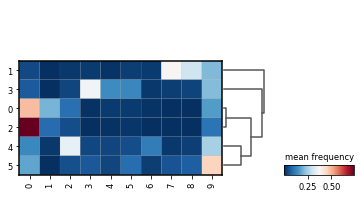

In [ ]:
sc.tl.dendrogram(adata_CN, groupby='CN')
sc.pl.matrixplot(adata_CN, adata_CN.var_names.tolist(), 'CN', dendrogram=True,
                 colorbar_title='mean frequency', cmap='RdBu_r')

In [ ]:
adata.obs['CN'] = labels
adata.obs['CN'] = adata.obs['CN'].astype('category')
adata.uns['CN_colors'] = sc.pl.palettes.vega_20_scanpy[:n_neighborhoods]
sc.tl.dendrogram(adata, groupby='CN')


    using data matrix X directly
Storing dendrogram info using `.uns['dendrogram_CN']`


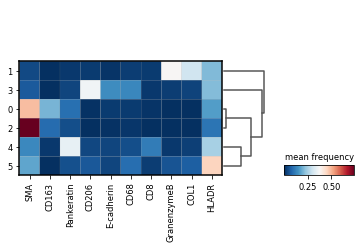

In [ ]:
sc.pl.matrixplot(adata, adata.var_names.tolist(), 'CN', dendrogram=True,
                 colorbar_title='mean frequency', cmap='RdBu_r')

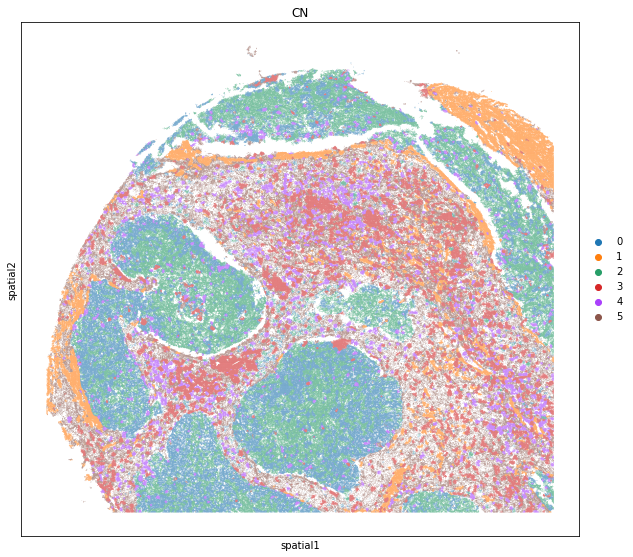

In [ ]:
with rc_context({'figure.figsize': (10, 10)}):
    sc.pl.spatial(
        adata_CN,
        color='CN',
        spot_size=1,
            )   

In [ ]:
colors = adata_CN.uns['CN_colors']
labels = np.unique(adata_CN.obs.CN.tolist())

colors_rgb = []
for color in colors:
    colors_rgb.append(matplotlib.colors.hex2color(color))
colors_rgb = np.array(colors_rgb)*255
colors_rgb = colors_rgb.astype(np.uint8)

In [217]:
spatial = adata_CN.obsm['spatial']
    
x = np.asarray(spatial[:,0])
y = np.asarray(spatial[:,1])
values = adata_CN.obs['CN'].to_numpy().astype(np.uint8)

x_max = np.max(x)+1
y_max = np.max(y)+1
img = np.zeros((x_max, y_max, 3), dtype=np.uint8)
img[y, x, :] = colors_rgb[values]

img = Image.fromarray(img)

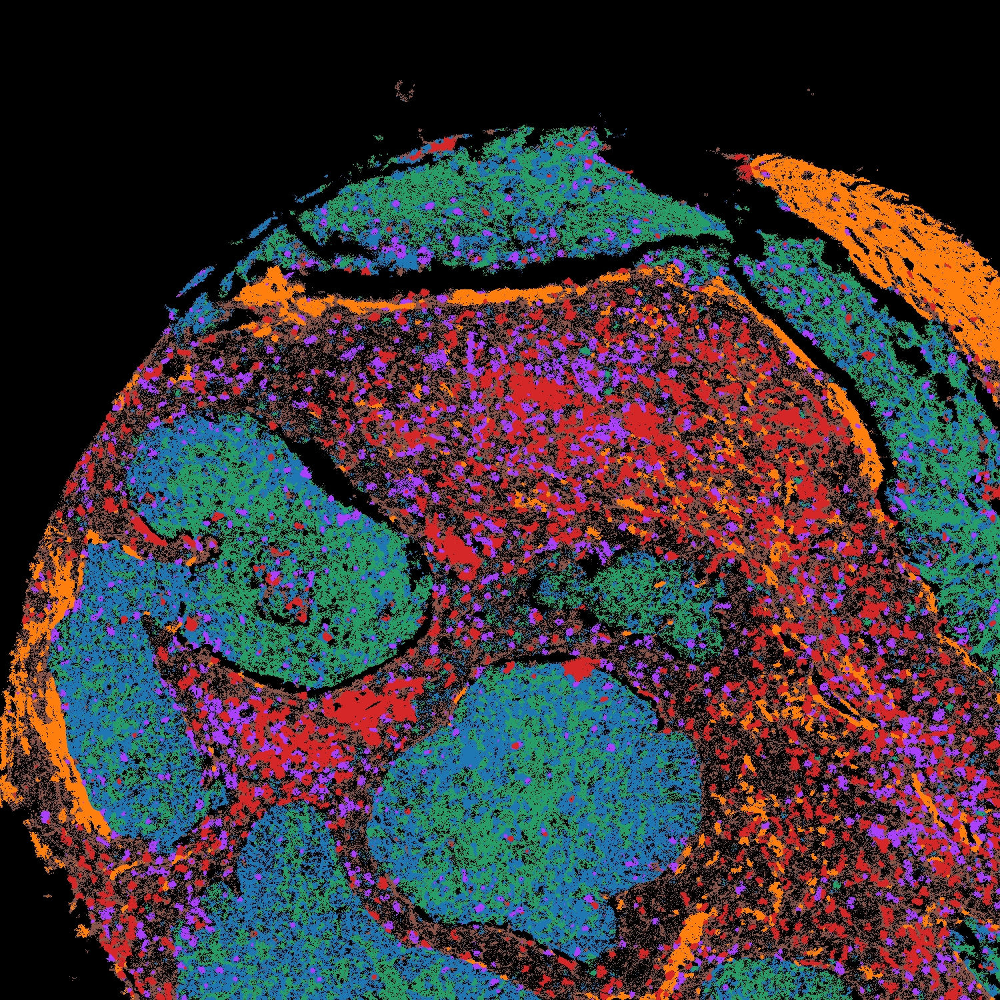

In [218]:
img